In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df=pd.read_csv('../raw data/Groceries_dataset.csv')
df['Date'] =  pd.to_datetime(df['Date'])

Get a dataframe by customer, showing true/false for each item purchased, ever.

In [3]:
df['n']=1
dummies_df=pd.pivot_table(df,index='Member_number',columns=['itemDescription'], values='n').fillna(0)
dummies_df.head()

itemDescription,Instant food products,UHT-milk,abrasive cleaner,artif. sweetener,baby cosmetics,bags,baking powder,bathroom cleaner,beef,berries,...,turkey,vinegar,waffles,whipped/sour cream,whisky,white bread,white wine,whole milk,yogurt,zwieback
Member_number,,,,,,,,,,,,,,,,,,,,,
1000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
1001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0
1002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


Let's look at how each item correlates to the others.  This may identify whether some products are strongly linked.

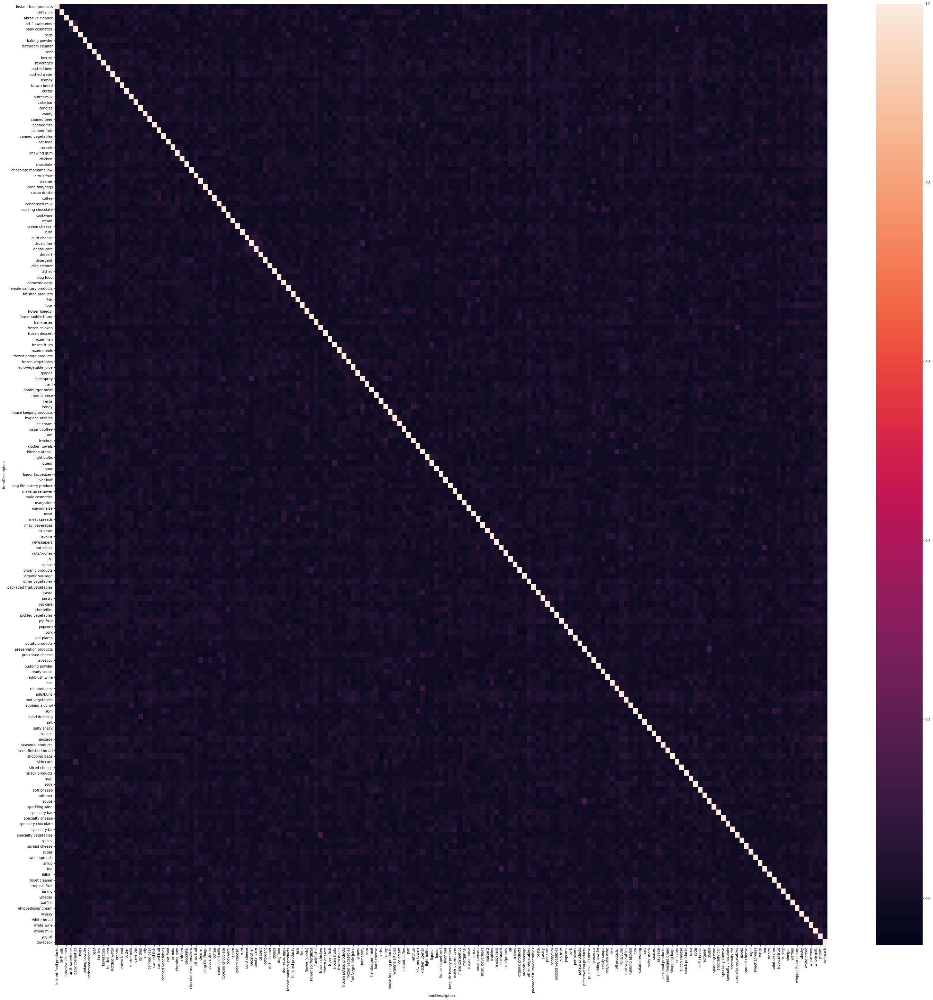

In [4]:
plt.figure(figsize=(50,50))
sns.heatmap(dummies_df.corr())

Well that's unwieldy.  Let's try again, this time only focusing on any pairs showing a correlation above .1

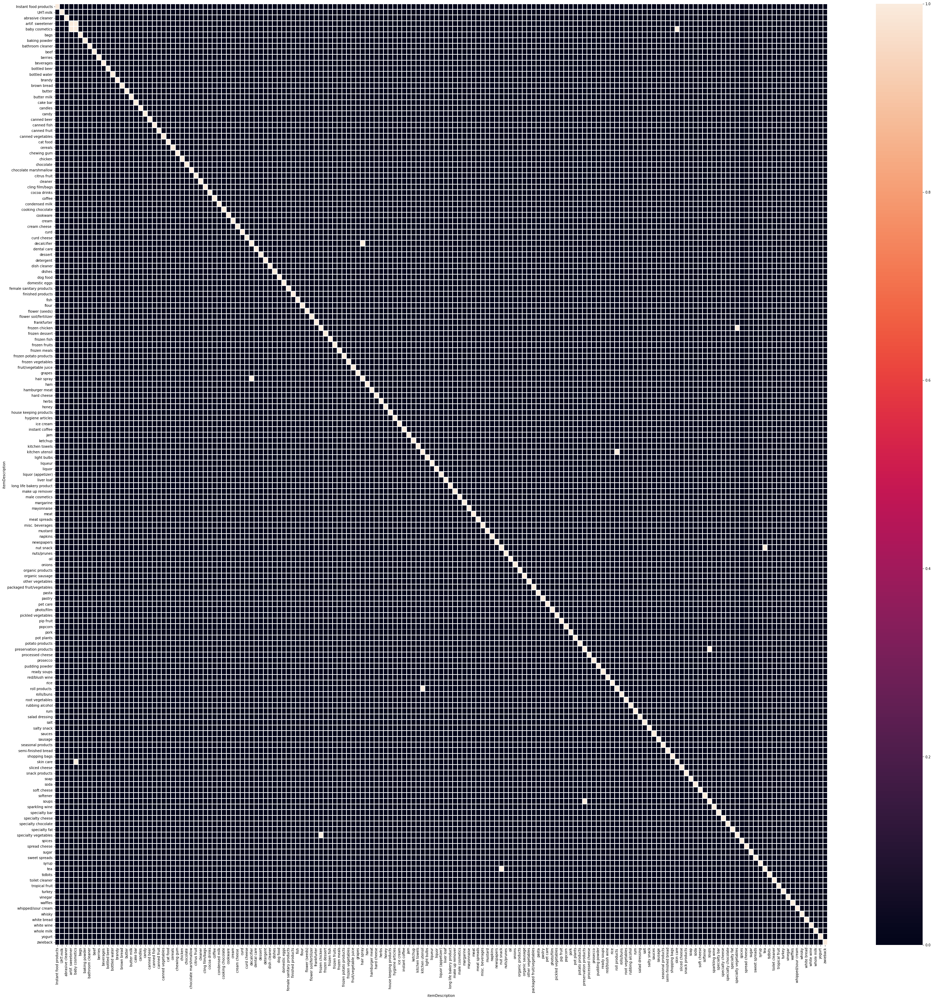

In [5]:
plt.figure(figsize=(50,50))
sns.heatmap(dummies_df.corr()>.1,linecolor='white',linewidth=1)

A few of those make sense, but some seem to be rarely purchased items.  
Items purchased rarely will show higher correlation to whichever items 
happened to be bought alongside them, regardless of how intrinsically 
linked they are.  How rarely are some things purchased?

itemDescription
preservation products       1.0
kitchen utensil             1.0
baby cosmetics              3.0
bags                        4.0
frozen chicken              5.0
                          ...  
yogurt                   1103.0
soda                     1222.0
rolls/buns               1363.0
other vegetables         1468.0
whole milk               1786.0
Length: 167, dtype: float64


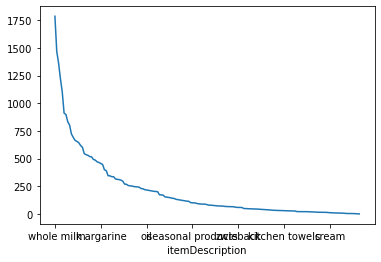

In [6]:
print(dummies_df.sum(axis=0).sort_values())
dummies_df.sum(axis=0).sort_values(ascending=False).plot()

Baby cosmetics were only purchased 3 times, so it makes sense that they 
were strongly correlated with seemingly unrelated stuff.  Let's drop 
any products purchased less than 100 times.

In [7]:
dummies_df.head()
for column in dummies_df.columns:
    if dummies_df.sum(axis=0)[column]<100:
        dummies_df.drop(columns=column,inplace=True)

dummies_df.shape

(3898, 77)

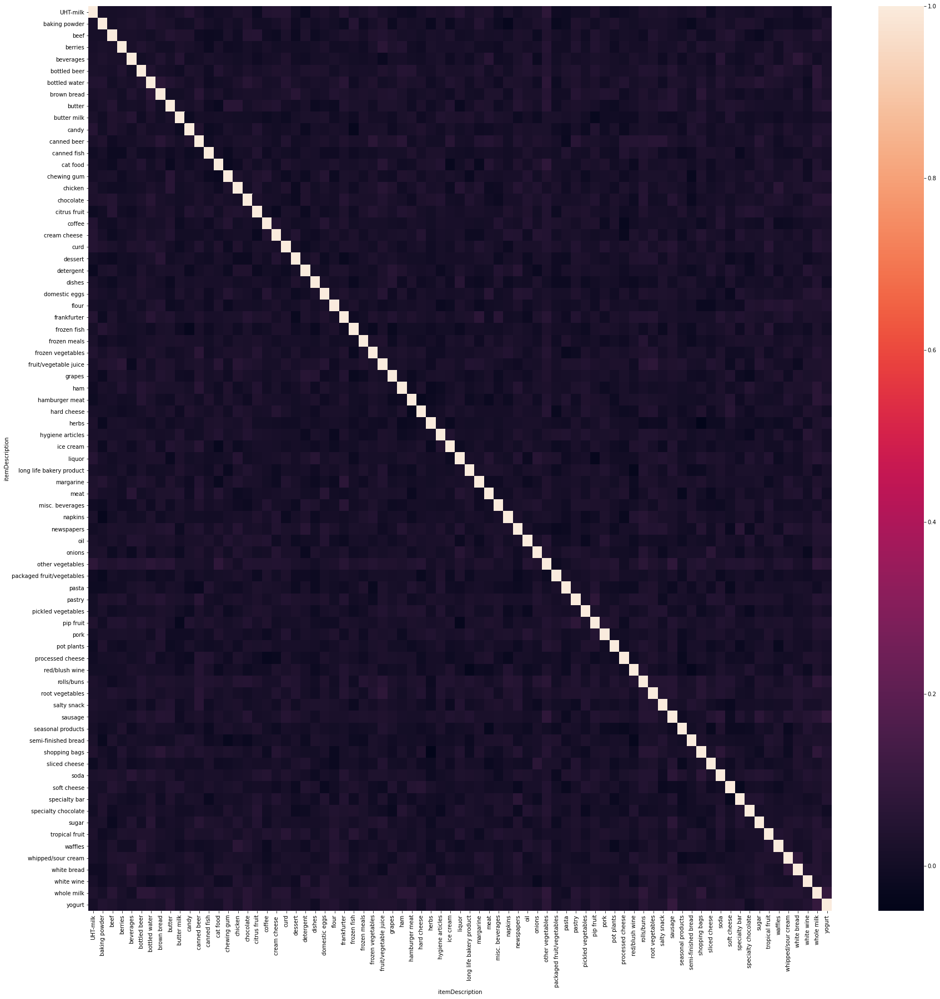

In [9]:
plt.figure(figsize=(30,30))
sns.heatmap(dummies_df.corr())

"other vegetables" seems to be a clear winner here, collelating with lots of other things.  
No meal is complete without a serving of veggies, so this makes sense.

What about customers?  Do some of them tend to have similar shopping needs to other customers?

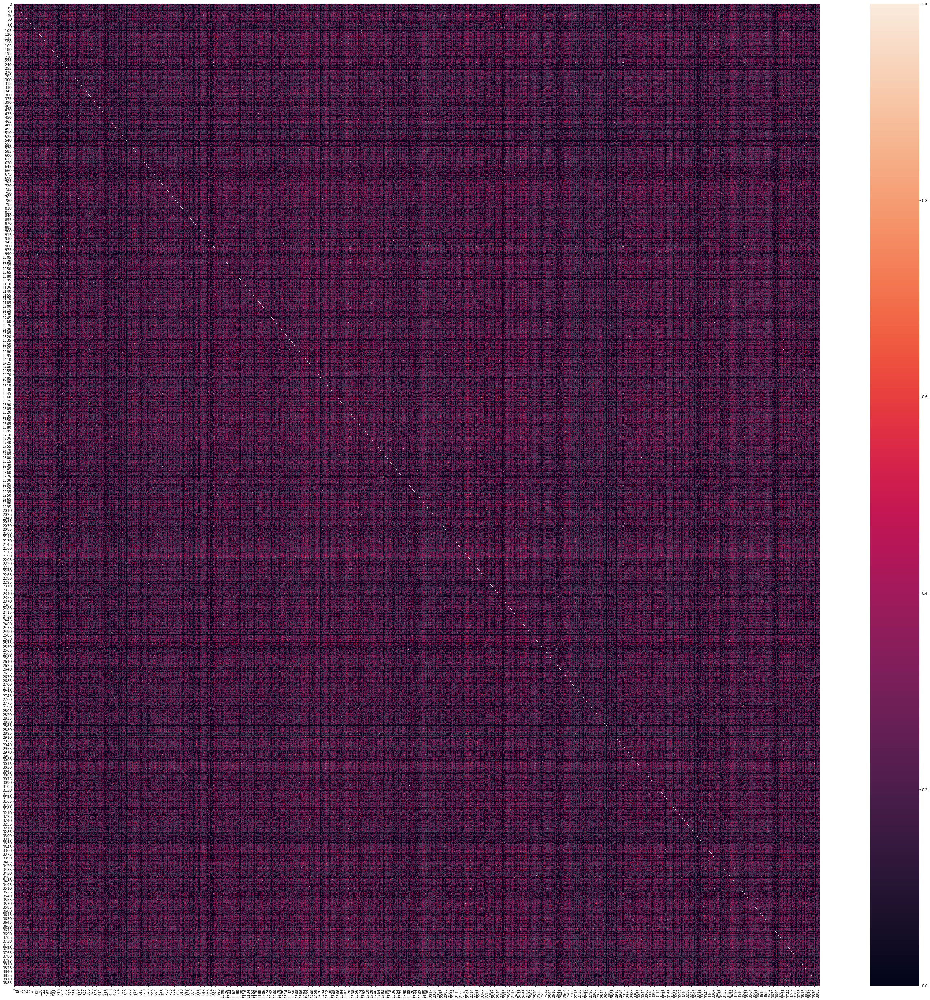

In [10]:
from sklearn.metrics.pairwise import cosine_similarity
plt.figure(figsize=(50,50))
sns.heatmap(cosine_similarity(dummies_df,dummies_df))

There are some oddballs in this group, represented by black lines that span the entire graph.
Those customers differ from most others.  This implies that there are some clusters that 
could be identified.

In [11]:
dummies_df.to_csv('../raw data/common purchases.csv')